<a href="https://colab.research.google.com/github/garzo94/ABtest_project/blob/main/A_B_test_mobile_app.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

from scipy import stats

import matplotlib.pylab as plt
import random
from google.colab import files # ti load our excel file

In [ ]:
df = pd.read_csv('/content/cookie_cats.csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90189 entries, 0 to 90188
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   userid          90189 non-null  int64 
 1   version         90189 non-null  object
 2   sum_gamerounds  90189 non-null  int64 
 3   retention_1     90189 non-null  bool  
 4   retention_7     90189 non-null  bool  
dtypes: bool(2), int64(2), object(1)
memory usage: 2.2+ MB


In [ ]:
df['sum_gamerounds'] = pd.to_numeric(df['sum_gamerounds'],errors='coerce')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90189 entries, 0 to 90188
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   userid          90189 non-null  int64 
 1   version         90189 non-null  object
 2   sum_gamerounds  90189 non-null  int64 
 3   retention_1     90189 non-null  bool  
 4   retention_7     90189 non-null  bool  
dtypes: bool(2), int64(2), object(1)
memory usage: 2.2+ MB


In [ ]:
df.dropna(inplace=True)


In [ ]:
df.head()

,userid,version,sum_gamerounds,retention_1,retention_7
0,116,gate_30,3,False,False
1,337,gate_30,38,True,False
2,377,gate_40,165,True,False
3,483,gate_40,1,False,False
4,488,gate_40,179,True,True


In [ ]:
# We are just going to analyze by sum of rounds and version so the remaining columns will be eliminated.

df.drop(labels=['userid', 'retention_1', 'retention_7'], axis=1, inplace=True)


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


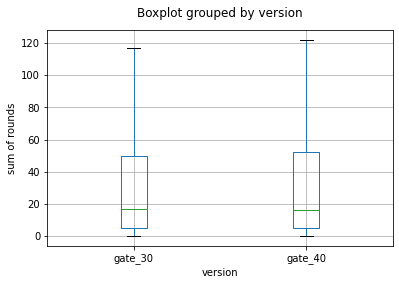

In [ ]:
fig = df.boxplot(by = "version",  column = "sum_gamerounds", showfliers=False)
fig.set_title('')
fig.set_title('')
fig.set_ylabel("sum of rounds")
plt.show()



In [ ]:
#Ho = no diference between both gates
#Hi = gate_30 shows better results

In [ ]:
mean_30 = df[df.version == 'gate_30'].sum_gamerounds.mean()
mean_40 = df[df.version == 'gate_40'].sum_gamerounds.mean()
mean_difference = mean_30 - mean_40
mean_difference


1.157488453953249

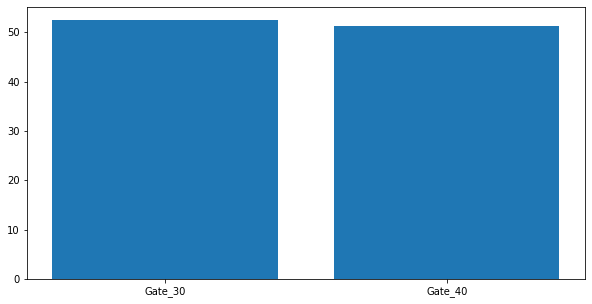

In [ ]:
fig =  plt.figure(figsize=(10,5))
values = [mean_30, mean_40] 
gate = ['Gate_30', 'Gate_40']
plt.bar(gate,values)
plt.show()

In [ ]:
#The Hipotessis null is apparently true, let's find out...


In [ ]:
#Permutation test
def perm_function(df, n30, n40):
    n = n30 + n40
    randm30 = set(random.sample(range(n), n30))
    randm40 = set(range(n)) - randm30
    print(randm30)
    return df.reindex(index= randm30).sum_gamerounds.mean() - df.reindex(index = randm40).sum_gamerounds.mean()

n30 = df[df.version ==  'gate_30'].sum_gamerounds.shape[0]
n40 = df[df.version ==  'gate_40'].sum_gamerounds.shape[0]
        
print(perm_function(df, n30,n40))

{0, 3, 6, 7, 8, 12, 16, 17, 18, 20, 23, 24, 25, 30, 34, 35, 36, 37, 39, 40, 43, 48, 49, 50, 51, 52, 54, 57, 58, 60, 62, 64, 66, 69, 70, 72, 78, 80, 81, 82, 84, 87, 88, 89, 91, 92, 93, 94, 95, 98, 99, 101, 102, 103, 104, 107, 109, 112, 113, 114, 115, 117, 118, 120, 122, 123, 124, 126, 127, 128, 131, 132, 133, 134, 140, 141, 143, 148, 151, 160, 164, 169, 172, 174, 176, 181, 182, 184, 189, 190, 191, 193, 196, 198, 199, 200, 203, 207, 208, 209, 210, 211, 212, 213, 216, 221, 224, 225, 226, 228, 229, 230, 231, 232, 234, 236, 239, 242, 244, 245, 246, 247, 249, 251, 253, 254, 255, 256, 262, 263, 264, 265, 266, 268, 269, 271, 272, 273, 274, 275, 277, 279, 280, 281, 282, 284, 288, 289, 290, 291, 292, 293, 297, 302, 303, 304, 305, 306, 307, 310, 311, 312, 313, 315, 318, 323, 324, 326, 327, 333, 337, 340, 346, 347, 349, 355, 356, 357, 363, 365, 367, 369, 371, 372, 375, 376, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 393, 394, 402, 404, 405, 407, 410, 411, 412, 414, 416, 417, 424, 425, 

In [ ]:
perm_diffs = [ perm_function(df, n30,n40) for perm in range(1000)]


{3, 5, 6, 7, 8, 10, 12, 13, 17, 20, 27, 32, 34, 36, 40, 41, 43, 49, 52, 53, 59, 61, 62, 64, 69, 72, 73, 74, 76, 77, 78, 80, 81, 82, 83, 85, 86, 90, 93, 98, 99, 101, 103, 107, 108, 109, 110, 112, 113, 114, 115, 116, 119, 120, 121, 123, 126, 127, 134, 135, 136, 138, 139, 141, 142, 143, 144, 145, 146, 147, 148, 150, 151, 152, 156, 157, 158, 159, 160, 162, 165, 168, 169, 171, 172, 173, 175, 176, 178, 179, 181, 183, 185, 187, 188, 191, 194, 197, 199, 200, 203, 205, 206, 208, 210, 211, 212, 213, 215, 217, 219, 222, 223, 226, 227, 229, 232, 233, 238, 240, 241, 242, 243, 245, 251, 256, 257, 259, 261, 266, 269, 271, 274, 276, 277, 279, 280, 283, 285, 286, 288, 291, 292, 293, 294, 296, 297, 298, 299, 304, 313, 314, 316, 317, 320, 322, 323, 324, 326, 328, 329, 330, 331, 332, 334, 338, 341, 342, 343, 344, 346, 347, 349, 350, 351, 352, 353, 355, 358, 359, 363, 364, 365, 366, 367, 368, 370, 371, 372, 374, 375, 377, 380, 382, 383, 384, 385, 386, 389, 391, 392, 394, 397, 400, 406, 408, 409, 410, 412, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 1, 4, 6, 7, 8, 10, 11, 12, 13, 15, 17, 19, 22, 24, 26, 27, 29, 30, 33, 38, 39, 40, 41, 42, 47, 49, 52, 55, 56, 57, 60, 62, 64, 65, 70, 71, 72, 73, 74, 76, 81, 84, 85, 86, 91, 93, 95, 97, 98, 101, 102, 106, 107, 108, 109, 110, 111, 115, 119, 121, 123, 125, 126, 128, 129, 130, 132, 134, 135, 137, 138, 139, 143, 145, 151, 153, 154, 157, 158, 160, 161, 164, 165, 166, 167, 168, 169, 170, 174, 179, 180, 185, 189, 192, 195, 197, 198, 199, 200, 201, 202, 203, 206, 209, 210, 213, 217, 218, 221, 226, 228, 230, 234, 236, 237, 240, 241, 242, 245, 246, 247, 248, 253, 257, 259, 260, 262, 263, 266, 268, 271, 273, 274, 276, 277, 278, 279, 280, 284, 285, 286, 291, 292, 298, 299, 300, 302, 306, 308, 311, 312, 314, 316, 317, 319, 323, 324, 326, 327, 328, 331, 333, 334, 336, 337, 339, 341, 344, 347, 349, 351, 352, 355, 356, 358, 359, 360, 362, 363, 364, 365, 367, 369, 371, 373, 376, 382, 383, 384, 385, 388, 389, 390, 394, 397, 398, 400, 404, 405, 408, 409, 410, 411, 412, 413, 415, 416, 417, 418, 419, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 5, 7, 8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 27, 28, 30, 31, 34, 35, 38, 39, 40, 41, 43, 48, 49, 50, 56, 57, 58, 61, 65, 66, 68, 69, 75, 79, 80, 81, 82, 91, 93, 94, 96, 98, 99, 100, 102, 104, 105, 106, 108, 110, 112, 114, 116, 117, 119, 120, 126, 127, 129, 130, 132, 134, 136, 137, 138, 139, 141, 142, 144, 145, 146, 149, 151, 152, 153, 154, 155, 156, 161, 162, 163, 164, 166, 168, 170, 172, 173, 175, 177, 178, 181, 183, 185, 188, 190, 192, 193, 194, 196, 199, 201, 202, 203, 205, 206, 207, 210, 211, 218, 220, 222, 223, 225, 226, 228, 230, 231, 233, 238, 239, 240, 243, 253, 255, 256, 257, 258, 259, 260, 262, 264, 274, 275, 276, 279, 281, 285, 286, 288, 290, 294, 296, 297, 298, 302, 303, 304, 310, 311, 313, 314, 315, 316, 317, 318, 320, 321, 323, 324, 327, 328, 331, 332, 334, 336, 337, 341, 342, 343, 345, 347, 349, 354, 356, 357, 361, 364, 365, 366, 367, 368, 369, 370, 371, 373, 374, 377, 378, 383, 384, 385, 387, 388, 389, 391, 394, 397, 398, 399, 400, 402, 403, 407, 408

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 4, 8, 9, 15, 16, 18, 20, 21, 27, 29, 30, 32, 33, 34, 35, 36, 42, 43, 44, 46, 47, 48, 51, 52, 53, 56, 58, 59, 60, 61, 64, 66, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 80, 82, 86, 90, 91, 92, 95, 99, 100, 104, 105, 106, 107, 108, 109, 111, 113, 117, 120, 124, 125, 126, 128, 129, 132, 133, 134, 135, 137, 138, 140, 147, 150, 153, 163, 164, 166, 168, 169, 172, 173, 174, 178, 186, 195, 197, 200, 202, 204, 205, 206, 207, 208, 212, 215, 219, 220, 228, 235, 240, 241, 245, 246, 248, 249, 250, 251, 252, 262, 263, 264, 265, 269, 272, 274, 275, 277, 279, 280, 283, 284, 286, 287, 289, 290, 291, 294, 295, 297, 299, 303, 305, 311, 312, 314, 317, 319, 321, 322, 325, 326, 332, 337, 340, 341, 342, 344, 345, 346, 347, 348, 350, 351, 354, 356, 359, 360, 364, 365, 368, 370, 372, 374, 379, 380, 381, 382, 384, 386, 387, 389, 390, 392, 398, 399, 402, 404, 407, 408, 409, 412, 413, 416, 420, 422, 423, 424, 428, 429, 430, 433, 435, 438, 439, 440, 443, 444, 448, 452, 453, 454, 456, 457, 465, 466, 467, 468, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 3, 4, 7, 8, 11, 15, 16, 17, 18, 21, 22, 27, 37, 39, 42, 44, 47, 48, 49, 50, 51, 52, 53, 54, 57, 59, 60, 61, 62, 63, 66, 68, 69, 70, 78, 79, 82, 83, 84, 88, 89, 90, 94, 95, 97, 99, 100, 103, 104, 107, 108, 109, 110, 112, 114, 115, 116, 117, 121, 122, 125, 126, 131, 135, 140, 142, 143, 144, 145, 146, 147, 149, 152, 153, 155, 156, 158, 159, 161, 162, 163, 164, 168, 170, 171, 172, 175, 177, 179, 181, 183, 186, 188, 189, 191, 192, 195, 196, 199, 200, 202, 208, 209, 210, 212, 213, 215, 217, 219, 221, 224, 225, 227, 231, 232, 236, 238, 241, 242, 243, 244, 246, 247, 248, 253, 255, 258, 260, 262, 267, 268, 269, 271, 274, 275, 276, 278, 279, 281, 282, 290, 292, 295, 296, 297, 298, 302, 304, 309, 310, 311, 312, 313, 315, 317, 319, 320, 321, 322, 324, 326, 328, 330, 333, 337, 339, 340, 342, 343, 349, 350, 351, 352, 354, 357, 359, 361, 362, 364, 365, 366, 367, 370, 371, 372, 373, 374, 375, 378, 379, 383, 384, 385, 386, 394, 395, 397, 403, 404, 405, 406, 408, 409, 410, 411, 414, 415, 416, 418

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 3, 5, 6, 9, 15, 16, 21, 24, 26, 27, 30, 31, 33, 34, 35, 37, 41, 42, 43, 44, 45, 51, 54, 55, 59, 60, 63, 65, 70, 73, 75, 76, 79, 83, 84, 87, 88, 89, 90, 91, 92, 96, 97, 100, 102, 103, 105, 106, 108, 109, 111, 114, 117, 118, 123, 125, 126, 127, 130, 132, 134, 135, 136, 137, 139, 140, 143, 148, 151, 155, 159, 160, 162, 164, 166, 167, 168, 173, 174, 181, 182, 183, 184, 185, 188, 189, 190, 192, 195, 197, 200, 202, 204, 205, 206, 208, 209, 211, 212, 213, 214, 215, 216, 217, 221, 223, 225, 228, 230, 231, 236, 237, 239, 241, 246, 250, 251, 254, 255, 259, 261, 262, 264, 265, 267, 268, 272, 273, 274, 275, 276, 277, 279, 281, 282, 283, 284, 285, 286, 289, 290, 291, 292, 294, 298, 301, 302, 305, 306, 309, 311, 313, 314, 316, 317, 321, 323, 325, 326, 327, 330, 331, 334, 335, 336, 338, 340, 341, 343, 345, 346, 350, 351, 353, 355, 356, 357, 361, 363, 365, 368, 369, 370, 371, 372, 373, 374, 375, 380, 383, 384, 389, 393, 394, 396, 397, 398, 399, 401, 404, 405, 406, 408, 409, 410, 411, 412, 414, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 1, 2, 11, 13, 17, 19, 23, 25, 26, 27, 28, 30, 31, 33, 34, 35, 36, 37, 38, 41, 42, 43, 44, 45, 46, 48, 52, 54, 55, 58, 59, 61, 62, 63, 64, 66, 68, 71, 72, 73, 75, 78, 79, 81, 86, 87, 89, 90, 92, 93, 96, 100, 103, 104, 106, 107, 109, 112, 114, 115, 116, 120, 123, 125, 126, 127, 129, 130, 131, 133, 134, 138, 140, 143, 146, 148, 150, 153, 154, 162, 163, 165, 166, 168, 170, 171, 172, 174, 175, 176, 177, 178, 181, 183, 185, 187, 190, 191, 193, 195, 197, 199, 205, 207, 210, 211, 214, 216, 217, 222, 225, 226, 232, 236, 237, 238, 242, 243, 247, 249, 251, 256, 257, 259, 260, 261, 263, 264, 265, 270, 272, 273, 274, 275, 278, 279, 281, 283, 284, 287, 288, 290, 292, 293, 297, 299, 300, 302, 305, 307, 309, 310, 312, 314, 315, 316, 317, 320, 321, 322, 323, 326, 329, 332, 337, 338, 340, 341, 342, 343, 344, 346, 347, 348, 351, 352, 353, 354, 356, 357, 361, 362, 363, 366, 367, 369, 372, 373, 374, 375, 381, 384, 386, 387, 388, 389, 390, 391, 392, 394, 395, 398, 400, 402, 403, 407, 410, 414, 415, 416,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 2, 4, 5, 6, 7, 8, 9, 12, 13, 14, 20, 21, 22, 25, 27, 31, 32, 33, 35, 37, 38, 39, 40, 43, 45, 47, 49, 51, 52, 54, 56, 57, 61, 62, 63, 65, 67, 68, 72, 74, 76, 77, 78, 79, 81, 83, 86, 87, 88, 90, 92, 93, 98, 100, 101, 102, 103, 106, 107, 108, 109, 111, 113, 115, 117, 121, 126, 127, 129, 130, 131, 132, 135, 136, 145, 146, 147, 148, 152, 153, 154, 155, 157, 158, 160, 161, 163, 167, 168, 171, 175, 177, 178, 182, 184, 188, 189, 192, 193, 195, 197, 199, 202, 204, 205, 206, 207, 209, 212, 214, 217, 225, 229, 232, 233, 244, 246, 248, 249, 250, 253, 256, 257, 260, 261, 262, 263, 267, 268, 273, 274, 278, 280, 281, 282, 283, 284, 285, 287, 288, 290, 291, 292, 294, 297, 298, 303, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 319, 320, 321, 322, 323, 324, 326, 327, 328, 331, 332, 335, 336, 339, 343, 344, 345, 346, 347, 349, 352, 354, 358, 359, 363, 364, 366, 367, 368, 370, 371, 375, 376, 377, 378, 381, 382, 384, 386, 389, 390, 392, 394, 395, 398, 400, 401, 402, 408, 410, 412, 414, 421, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 3, 4, 6, 7, 8, 9, 12, 13, 14, 16, 17, 19, 21, 23, 26, 28, 32, 39, 41, 43, 44, 46, 49, 50, 51, 53, 54, 58, 60, 61, 63, 64, 65, 66, 67, 68, 70, 71, 72, 74, 78, 79, 82, 86, 87, 89, 90, 91, 98, 100, 103, 105, 106, 107, 111, 114, 115, 116, 117, 119, 126, 127, 130, 132, 134, 136, 137, 139, 141, 145, 146, 147, 150, 151, 158, 159, 160, 166, 167, 171, 172, 174, 176, 177, 180, 183, 184, 185, 186, 188, 189, 190, 191, 193, 194, 196, 197, 200, 202, 203, 206, 208, 211, 215, 219, 221, 225, 230, 232, 234, 235, 236, 241, 244, 247, 248, 249, 250, 251, 252, 253, 256, 258, 260, 261, 263, 265, 267, 269, 271, 272, 273, 275, 276, 279, 280, 281, 282, 283, 285, 286, 287, 291, 292, 295, 297, 299, 301, 305, 308, 310, 311, 313, 317, 318, 320, 321, 324, 325, 327, 328, 329, 330, 333, 338, 339, 340, 341, 342, 346, 348, 349, 352, 358, 362, 365, 367, 368, 369, 370, 371, 372, 377, 381, 382, 383, 384, 385, 387, 388, 391, 393, 397, 398, 399, 400, 401, 402, 405, 406, 408, 410, 411, 412, 415, 419, 421, 423, 426, 435, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 2, 4, 5, 6, 9, 10, 11, 12, 13, 15, 17, 19, 22, 23, 28, 30, 39, 41, 43, 44, 45, 50, 51, 55, 57, 60, 61, 62, 64, 66, 67, 69, 74, 79, 82, 83, 84, 85, 92, 93, 99, 101, 104, 105, 106, 110, 112, 114, 115, 116, 118, 121, 122, 123, 129, 130, 131, 132, 133, 134, 135, 137, 140, 147, 148, 149, 153, 154, 157, 158, 159, 161, 162, 164, 166, 170, 172, 173, 174, 175, 178, 179, 184, 186, 188, 189, 191, 195, 196, 198, 199, 200, 202, 203, 205, 206, 207, 209, 210, 211, 214, 215, 216, 217, 219, 220, 223, 225, 228, 229, 230, 231, 232, 237, 238, 239, 241, 242, 244, 247, 248, 250, 251, 253, 254, 260, 267, 269, 272, 273, 275, 277, 278, 279, 280, 282, 283, 285, 286, 287, 288, 291, 295, 297, 298, 301, 303, 304, 307, 310, 311, 312, 313, 314, 315, 321, 323, 324, 327, 328, 331, 333, 336, 338, 340, 342, 345, 346, 348, 349, 350, 354, 356, 357, 359, 361, 365, 366, 367, 368, 369, 370, 375, 376, 379, 380, 381, 384, 385, 393, 394, 397, 401, 402, 405, 406, 408, 409, 411, 412, 413, 416, 419, 420, 421, 423, 424, 428, 42

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{2, 3, 9, 11, 13, 16, 17, 20, 21, 22, 25, 26, 27, 29, 30, 32, 34, 36, 37, 40, 41, 44, 45, 46, 51, 52, 53, 54, 56, 57, 59, 61, 65, 67, 75, 76, 77, 79, 80, 81, 82, 84, 87, 89, 91, 92, 95, 97, 99, 102, 103, 104, 105, 107, 111, 112, 113, 114, 115, 116, 117, 119, 120, 122, 125, 126, 127, 129, 130, 132, 133, 134, 136, 138, 139, 140, 144, 151, 155, 156, 157, 159, 160, 162, 163, 166, 167, 171, 173, 174, 175, 177, 178, 179, 180, 182, 186, 190, 191, 193, 195, 197, 200, 201, 202, 203, 207, 210, 213, 214, 215, 218, 221, 222, 223, 224, 227, 229, 233, 234, 236, 240, 243, 244, 247, 248, 249, 253, 255, 258, 259, 260, 263, 264, 270, 271, 273, 275, 278, 280, 284, 288, 289, 291, 294, 295, 298, 301, 306, 307, 308, 310, 311, 317, 319, 321, 322, 323, 324, 326, 328, 330, 331, 334, 336, 338, 340, 343, 346, 347, 348, 349, 351, 352, 357, 358, 359, 360, 362, 363, 364, 368, 369, 370, 371, 373, 374, 375, 380, 381, 384, 385, 386, 387, 388, 389, 390, 394, 397, 401, 402, 404, 407, 412, 413, 414, 416, 417, 425, 426, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 1, 2, 3, 4, 5, 8, 11, 15, 16, 18, 21, 23, 24, 27, 28, 29, 30, 32, 34, 37, 40, 43, 44, 45, 46, 47, 48, 49, 50, 57, 58, 59, 60, 66, 68, 70, 71, 74, 76, 77, 78, 81, 82, 85, 86, 87, 91, 95, 96, 100, 104, 107, 112, 113, 114, 116, 118, 120, 121, 122, 123, 126, 129, 130, 138, 141, 142, 146, 147, 152, 155, 157, 160, 161, 162, 169, 170, 172, 176, 178, 181, 187, 188, 190, 191, 192, 193, 194, 195, 196, 200, 201, 202, 204, 207, 211, 216, 220, 223, 224, 226, 227, 228, 229, 230, 234, 235, 236, 237, 239, 240, 241, 242, 245, 246, 248, 254, 255, 256, 257, 261, 266, 268, 270, 273, 276, 277, 283, 284, 286, 290, 291, 292, 294, 298, 300, 302, 305, 306, 310, 311, 312, 313, 314, 315, 320, 323, 325, 327, 334, 336, 339, 340, 341, 343, 344, 345, 347, 350, 351, 352, 354, 356, 357, 360, 361, 362, 363, 367, 369, 370, 372, 375, 377, 378, 379, 382, 384, 385, 386, 388, 391, 394, 399, 402, 405, 408, 409, 411, 412, 414, 415, 417, 425, 426, 430, 435, 436, 438, 441, 444, 445, 446, 447, 455, 458, 459, 460, 468, 470, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 7, 9, 12, 13, 15, 16, 17, 19, 23, 28, 32, 33, 34, 35, 37, 42, 43, 44, 47, 49, 50, 55, 57, 58, 62, 66, 67, 69, 70, 73, 74, 78, 79, 83, 85, 86, 91, 92, 93, 96, 98, 101, 103, 104, 105, 108, 109, 115, 119, 122, 123, 124, 129, 131, 132, 133, 136, 139, 140, 141, 142, 143, 144, 145, 147, 148, 149, 151, 152, 153, 158, 159, 161, 165, 166, 167, 168, 170, 171, 172, 173, 176, 178, 179, 180, 181, 183, 186, 189, 190, 191, 192, 194, 195, 196, 197, 199, 203, 205, 207, 214, 216, 219, 221, 223, 224, 228, 231, 232, 234, 235, 236, 237, 238, 239, 240, 244, 245, 246, 247, 252, 253, 257, 261, 262, 266, 267, 272, 274, 277, 278, 279, 280, 281, 286, 288, 290, 291, 293, 295, 296, 297, 298, 299, 302, 303, 304, 306, 307, 308, 312, 315, 316, 317, 318, 321, 324, 325, 326, 328, 329, 330, 331, 334, 335, 338, 340, 343, 344, 345, 346, 347, 348, 349, 350, 351, 353, 354, 358, 362, 364, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 379, 380, 381, 382, 386, 387, 389, 390, 391, 396, 398, 400, 401, 402, 403, 405, 406,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 1, 4, 8, 9, 10, 11, 13, 14, 17, 19, 20, 23, 27, 28, 29, 30, 31, 34, 38, 39, 40, 41, 42, 43, 45, 48, 56, 57, 58, 59, 60, 62, 65, 69, 70, 73, 76, 78, 81, 83, 84, 85, 90, 91, 92, 101, 103, 104, 105, 106, 109, 112, 113, 114, 116, 117, 119, 120, 121, 124, 125, 126, 128, 129, 132, 133, 136, 139, 140, 143, 144, 145, 146, 150, 151, 152, 153, 155, 157, 159, 160, 161, 162, 164, 168, 169, 171, 172, 173, 174, 178, 179, 182, 184, 185, 188, 189, 190, 194, 197, 198, 200, 202, 203, 205, 210, 212, 215, 223, 224, 226, 231, 232, 234, 239, 241, 242, 243, 249, 250, 251, 252, 253, 254, 256, 257, 258, 259, 261, 262, 264, 265, 269, 272, 274, 279, 280, 283, 286, 288, 290, 291, 292, 296, 299, 300, 301, 304, 306, 307, 308, 311, 312, 313, 314, 315, 316, 317, 319, 321, 323, 327, 330, 333, 334, 335, 338, 339, 340, 341, 342, 343, 344, 345, 346, 348, 350, 352, 354, 356, 358, 359, 361, 363, 368, 369, 370, 374, 375, 376, 377, 378, 379, 383, 384, 390, 391, 392, 393, 394, 395, 396, 402, 404, 405, 406, 407, 409, 410, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 6, 10, 11, 13, 16, 17, 20, 22, 25, 30, 31, 32, 33, 34, 37, 39, 40, 41, 47, 48, 50, 51, 52, 53, 54, 55, 57, 60, 61, 64, 67, 69, 70, 76, 78, 80, 82, 83, 86, 87, 88, 90, 93, 95, 96, 98, 99, 100, 101, 102, 104, 107, 109, 114, 116, 122, 123, 124, 127, 128, 132, 133, 134, 136, 138, 139, 142, 144, 147, 148, 153, 155, 156, 159, 163, 164, 167, 168, 169, 173, 174, 176, 182, 187, 188, 189, 190, 192, 193, 195, 196, 198, 199, 201, 202, 206, 209, 210, 211, 212, 214, 217, 218, 220, 222, 223, 224, 225, 226, 227, 230, 234, 236, 237, 238, 240, 241, 244, 248, 252, 253, 254, 255, 261, 264, 265, 268, 271, 273, 275, 276, 278, 279, 280, 286, 289, 290, 291, 293, 294, 295, 296, 297, 301, 302, 303, 304, 305, 310, 311, 312, 313, 315, 316, 317, 322, 323, 326, 327, 328, 330, 331, 332, 333, 335, 339, 341, 343, 344, 350, 351, 354, 356, 357, 359, 360, 366, 368, 369, 370, 375, 377, 382, 383, 384, 386, 389, 390, 391, 395, 396, 397, 398, 400, 402, 404, 405, 410, 411, 412, 413, 415, 416, 418, 420, 421, 422, 424, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 3, 7, 10, 11, 13, 15, 17, 18, 19, 21, 22, 25, 29, 31, 32, 34, 35, 38, 41, 42, 43, 45, 48, 49, 54, 55, 57, 60, 63, 64, 66, 68, 70, 71, 74, 75, 78, 80, 81, 85, 86, 88, 89, 90, 93, 99, 102, 103, 105, 109, 110, 111, 112, 114, 116, 118, 120, 121, 122, 123, 124, 126, 130, 131, 132, 135, 136, 137, 138, 139, 140, 143, 144, 145, 149, 150, 151, 154, 155, 157, 160, 162, 166, 168, 170, 171, 176, 177, 178, 179, 180, 181, 182, 183, 186, 187, 188, 189, 194, 196, 199, 200, 201, 202, 203, 206, 213, 214, 221, 222, 223, 224, 226, 227, 229, 230, 232, 233, 236, 242, 243, 244, 246, 247, 250, 253, 254, 258, 260, 263, 264, 265, 269, 271, 272, 273, 274, 275, 276, 277, 279, 281, 283, 284, 285, 289, 290, 293, 294, 296, 297, 302, 303, 307, 309, 310, 315, 318, 319, 320, 322, 325, 326, 328, 330, 332, 337, 341, 342, 345, 346, 347, 349, 350, 351, 354, 356, 357, 362, 363, 364, 365, 368, 369, 370, 371, 372, 373, 374, 375, 376, 378, 379, 381, 382, 384, 385, 389, 394, 395, 397, 399, 403, 404, 408, 409, 410, 412, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 1, 2, 3, 4, 5, 7, 10, 13, 15, 16, 22, 23, 25, 28, 30, 32, 36, 39, 40, 41, 42, 43, 46, 48, 49, 50, 52, 53, 57, 58, 60, 63, 66, 68, 69, 71, 72, 76, 77, 79, 86, 88, 90, 91, 92, 94, 96, 97, 99, 102, 106, 109, 112, 114, 115, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 129, 130, 131, 132, 133, 134, 135, 140, 143, 144, 145, 146, 148, 149, 150, 151, 152, 154, 155, 156, 160, 162, 164, 166, 171, 173, 176, 177, 179, 180, 182, 183, 184, 190, 192, 194, 196, 197, 198, 199, 200, 201, 202, 204, 205, 210, 213, 216, 217, 218, 220, 228, 229, 230, 231, 232, 233, 236, 237, 239, 240, 241, 243, 244, 246, 248, 249, 250, 251, 253, 254, 257, 259, 263, 267, 269, 270, 272, 273, 274, 275, 276, 277, 278, 279, 282, 285, 287, 288, 293, 295, 298, 299, 300, 306, 307, 313, 317, 319, 320, 324, 325, 326, 327, 330, 331, 333, 335, 339, 341, 342, 343, 344, 346, 347, 349, 350, 352, 356, 357, 363, 365, 369, 370, 372, 373, 376, 377, 378, 380, 383, 384, 386, 389, 391, 392, 394, 398, 402, 403, 405, 406, 407, 410, 411, 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 18, 20, 21, 24, 25, 29, 35, 37, 38, 40, 41, 45, 46, 48, 52, 56, 57, 61, 65, 67, 68, 72, 74, 75, 76, 77, 82, 83, 84, 85, 88, 90, 92, 93, 95, 98, 99, 102, 103, 106, 108, 109, 110, 112, 113, 114, 117, 118, 121, 122, 123, 124, 125, 126, 127, 131, 133, 134, 136, 138, 139, 140, 141, 142, 143, 144, 145, 148, 149, 151, 152, 154, 158, 159, 160, 163, 168, 170, 174, 176, 177, 181, 184, 185, 186, 189, 190, 191, 192, 193, 194, 195, 196, 199, 202, 204, 205, 206, 211, 212, 213, 215, 216, 217, 218, 220, 224, 225, 226, 227, 228, 232, 235, 237, 238, 241, 242, 243, 246, 247, 249, 251, 253, 255, 256, 258, 259, 260, 261, 262, 263, 264, 269, 270, 271, 275, 276, 278, 279, 281, 282, 283, 286, 287, 288, 290, 291, 294, 295, 296, 297, 298, 300, 301, 303, 304, 305, 306, 307, 309, 311, 314, 316, 317, 318, 321, 322, 323, 324, 325, 326, 331, 332, 334, 338, 339, 340, 341, 343, 345, 346, 351, 352, 353, 354, 355, 356, 358, 359, 360, 363, 366, 367, 370, 373, 374, 375, 376

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0, 2, 7, 8, 9, 11, 14, 17, 19, 20, 21, 22, 25, 26, 27, 28, 30, 32, 34, 35, 36, 37, 38, 52, 54, 61, 65, 66, 68, 71, 73, 77, 81, 82, 83, 84, 85, 90, 92, 94, 99, 100, 101, 103, 106, 107, 108, 110, 114, 115, 116, 117, 119, 120, 122, 123, 124, 125, 131, 132, 133, 136, 139, 140, 142, 144, 150, 151, 154, 159, 162, 163, 166, 167, 169, 172, 173, 175, 177, 179, 180, 181, 183, 185, 186, 188, 190, 196, 198, 200, 204, 206, 207, 212, 219, 222, 223, 224, 225, 226, 227, 229, 230, 231, 233, 235, 236, 237, 238, 239, 240, 246, 250, 251, 253, 254, 255, 256, 257, 258, 260, 262, 263, 264, 265, 267, 270, 271, 272, 273, 274, 276, 277, 278, 279, 281, 283, 284, 285, 288, 289, 292, 295, 299, 300, 301, 302, 304, 306, 307, 309, 310, 316, 318, 322, 323, 324, 328, 329, 330, 332, 335, 336, 339, 340, 341, 342, 343, 347, 348, 349, 351, 352, 353, 355, 356, 357, 358, 360, 361, 362, 364, 369, 371, 379, 387, 391, 393, 394, 398, 403, 408, 411, 412, 413, 414, 416, 422, 423, 426, 428, 429, 432, 436, 438, 439, 440, 441, 443, 

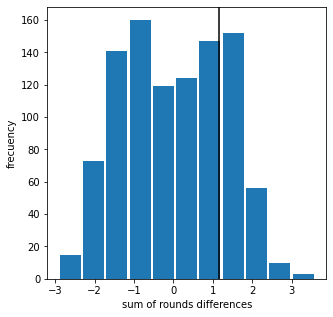

In [ ]:
fig, ax = plt.subplots(figsize = (5,5))
ax.hist(perm_diffs, bins=11, rwidth=0.9)
ax.axvline(x= mean_30-mean_40, color = 'black')
ax.set_xlabel('sum of rounds differences')
ax.set_ylabel('frecuency')
plt.show()


In [ ]:
#P-value

P-value


In [ ]:
np.mean([diff > mean_difference for diff in perm_diffs])

0.247

In [ ]:
# means that we would expect to achieve a result as extreme as this, 
# or a more extreme result, by random chance over 23% of the time.

T-test

In [ ]:
df.head()

,version,sum_gamerounds
0,gate_30,3
1,gate_30,38
2,gate_40,165
3,gate_40,1
4,gate_40,179


In [ ]:
res = stats.ttest_ind(df[df.version == 'gate_30'].sum_gamerounds, 
                      df[df.version == 'gate_40'].sum_gamerounds,
                      equal_var=False)
print(f'p-value for single sided test: {res.pvalue / 2:.4f}')

p-value for single sided test: 0.1880


In [ ]:
#With t-test we obtain a close p-value to permutation test.